In [1]:
import glob
import numpy as np
import matplotlib.pyplot as plt
from astropy.table import Table
import matplotlib.font_manager as font_manager
from matplotlib.ticker import (MultipleLocator, FormatStrFormatter,
                               AutoMinorLocator)
font_prop = font_manager.FontProperties(size=18)
plt.rcParams["font.family"] = "Times"
%matplotlib inline

files = glob.glob("test_*.fits")

In [2]:
len(files)

305

In [3]:
files[0].split("_")[1].split(".fits")[0]

'95.5'

In [4]:
science = []
calib = []
known_spec = []
angle = []
for i in files:
    data2 = Table.read(i, hdu = 2, format='fits')
    data1 = Table.read(i, hdu = 1, format='fits')
    angle.append(float(i.split("_")[1].split(".fits")[0]))
    #masking for assignment allocation
    assigned_SCIENCEfibers = ((data2['assigned'] == 1) & (data1['category'] == 'science'))
    assigned_CALIBfibers = ((data2['assigned'] == 1) & ((data1['category'] == 'sky_boss') | (data1['category'] == 'standard_boss')))


    #Carton breakdown
    assigned_known = ((data2['assigned'] == 1) & (data1['carton'] == 'bhm_rm_known_spec'))
    #assigned_core = ((data2['assigned'] == 1) & (data1['carton'] == 'bhm_rm_core'))
    #assigned_var = ((data2['assigned'] == 1) & (data1['carton'] == 'bhm_rm_var'))
    #assigned_ancil = ((data2['assigned'] == 1) & (data1['carton'] == 'bhm_rm_ancillary'))
    
    science.append(len(data1[assigned_SCIENCEfibers]))
    calib.append(len(data1[assigned_CALIBfibers]))
    known_spec.append(len(data1[assigned_known]))

science = np.array(science)
calib = np.array(calib)
known_spec = np.array(known_spec)
angle = np.array(angle)

In [7]:
angle[np.argmin(known_spec)]

151.0

In [15]:
mask = (calib < 120.)
print("known", known_spec[mask])
print("angle", angle[mask])

known [319 313 323]
angle [123.   20.5 120. ]


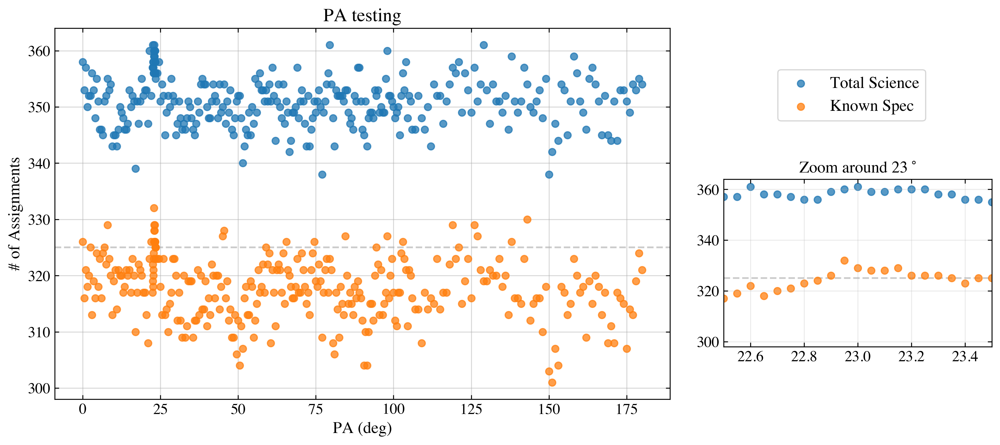

In [33]:
size = 14

#fig
fig, ax = plt.subplots(figsize=(8, 5), dpi=300, facecolor='white')
fig.tight_layout()
#field center lines
ax.axhline(y=325, linestyle='--', color='black', alpha=0.2, zorder=0)
#plot
ax.scatter(angle, science, alpha=0.75,label="Total Science")
ax.scatter(angle, known_spec, alpha=0.75,label="Known Spec")

#labels, etc
ax.set_xlabel("PA (deg)", fontsize=size)
ax.set_ylabel("# of Assignments", fontsize=size)
ax.set_title("PA testing", fontsize=size+2)
ax.tick_params(axis='both', which='major', labelsize=size-1, 
               top=True, right=True, bottom=True, left=True, direction='in')
ax.tick_params(axis='both', which='minor', labelsize=size-1, 
               top=True, right=True, bottom=True, left=True, direction='in')
plt.grid(alpha=0.5)
ax.set_axisbelow(True) 
plt.legend(loc=(1.175, 0.75), prop={"size":size})

inset_ax = fig.add_axes([1.05, 0.2, 0.4, 0.4]) 

inset_ax.scatter(angle, science, alpha=0.75,label="Total Science")
inset_ax.scatter(angle, known_spec, alpha=0.75,label="Known Spec")

inset_ax.set_title(r'Zoom around 23$^\circ$', fontsize=size)
inset_ax.axhline(y=325, linestyle='--', color='black', alpha=0.2, zorder=0)
# set axis range
inset_ax.set_xlim(22.5, 23.5)
plt.grid(alpha=0.25)
#inset_ax.set_ylim(-.005, .01)
inset_ax.tick_params(axis='both', which='major', labelsize=size-1, 
               top=True, right=True, bottom=True, left=True, direction='in')
inset_ax.tick_params(axis='both', which='minor', labelsize=size-1, 
               top=True, right=True, bottom=True, left=True, direction='in')
# set axis tick locations
inset_ax.set_yticks([300, 320, 340, 360])
#inset_ax.set_xticks([-0.1,0,.1]);



#plt.savefig("PA_testing.png", facecolor=fig.get_facecolor(), bbox_inches='tight',dpi=300)

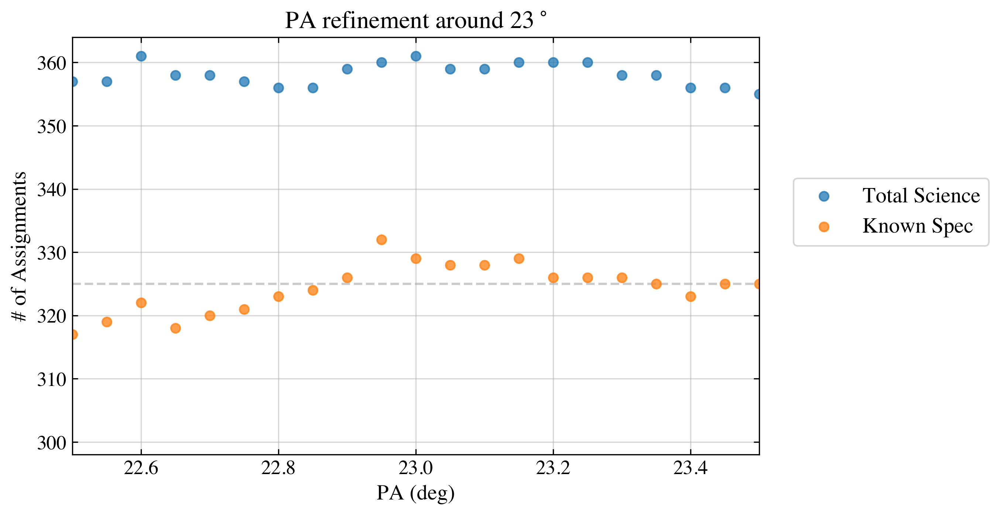

In [14]:
size = 14

#fig
fig, ax = plt.subplots(figsize=(8, 5), dpi=300, facecolor='white')
#field center lines
ax.axhline(y=325, linestyle='--', color='black', alpha=0.2, zorder=0)
#plot
ax.scatter(angle, science, alpha=0.75,label="Total Science")
ax.scatter(angle, known_spec, alpha=0.75,label="Known Spec")

#labels, etc
ax.set_xlabel("PA (deg)", fontsize=size)
ax.set_ylabel("# of Assignments", fontsize=size)
ax.set_title(r"PA refinement around 23$^\circ$", fontsize=size+2)
ax.tick_params(axis='both', which='major', labelsize=size-1, 
               top=True, right=True, bottom=True, left=True, direction='in')
ax.tick_params(axis='both', which='minor', labelsize=size-1, 
               top=True, right=True, bottom=True, left=True, direction='in')
plt.grid(alpha=0.5)
ax.set_axisbelow(True)        
plt.xlim(22.5,23.5)



plt.legend(loc=(1.05, 0.5), prop={"size":size})
#plt.savefig("PA_refinement.png", facecolor=fig.get_facecolor(), bbox_inches='tight',dpi=300)

In [6]:
max_mask = (known_spec >= 325)
print(angle[max_mask][-3], known_spec[max_mask][-3])
print(angle[max_mask][12], known_spec[max_mask][12])

45.5 328
119.0 329


In [19]:
files

['test_95.5.fits',
 'test_2.5.fits',
 'test_87.5.fits',
 'test_99.5.fits',
 'test_84.0.fits',
 'test_96.0.fits',
 'test_1.0.fits',
 'test_88.0.fits',
 'test_22.0.fits',
 'test_17.5.fits',
 'test_156.0.fits',
 'test_74.5.fits',
 'test_135.0.fits',
 'test_100.5.fits',
 'test_41.0.fits',
 'test_148.0.fits',
 'test_139.0.fits',
 'test_23.4.fits',
 'test_78.5.fits',
 'test_30.0.fits',
 'test_144.0.fits',
 'test_127.0.fits',
 'test_66.5.fits',
 'test_53.0.fits',
 'test_172.0.fits',
 'test_33.5.fits',
 'test_111.0.fits',
 'test_50.5.fits',
 'test_18.0.fits',
 'test_65.0.fits',
 'test_14.0.fits',
 'test_69.0.fits',
 'test_21.5.fits',
 'test_160.0.fits',
 'test_42.5.fits',
 'test_103.0.fits',
 'test_77.0.fits',
 'test_125.0.fits',
 'test_64.5.fits',
 'test_158.0.fits',
 'test_19.5.fits',
 'test_51.0.fits',
 'test_32.0.fits',
 'test_146.0.fits',
 'test_76.5.fits',
 'test_137.0.fits',
 'test_102.5.fits',
 'test_43.0.fits',
 'test_20.0.fits',
 'test_68.5.fits',
 'test_129.0.fits',
 'test_15.5.fits

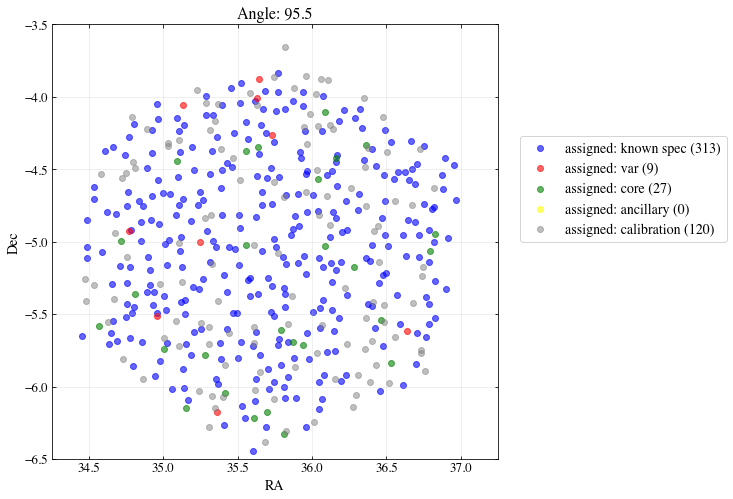

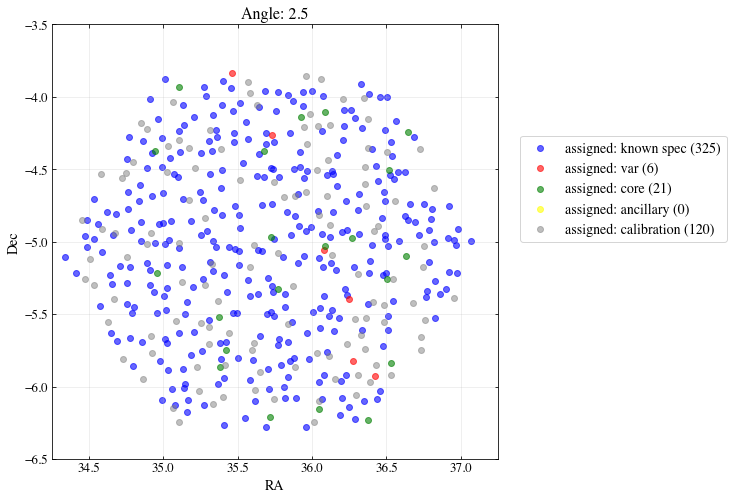

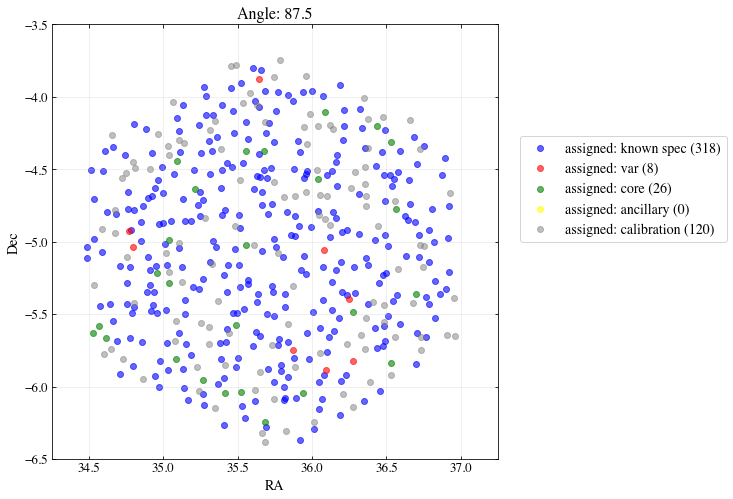

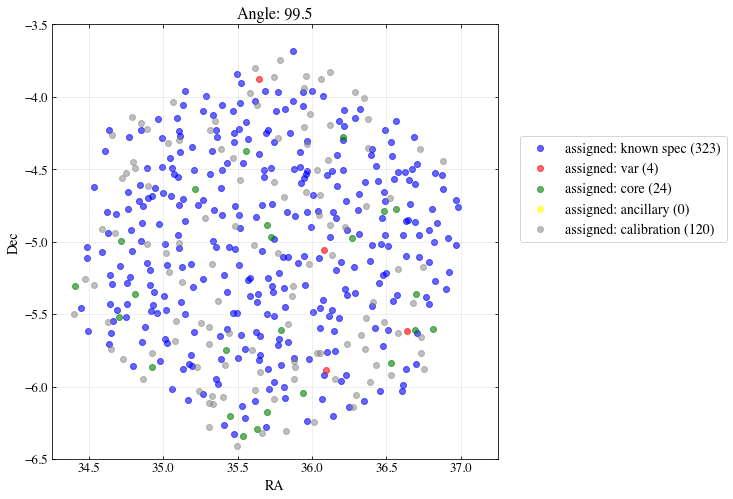

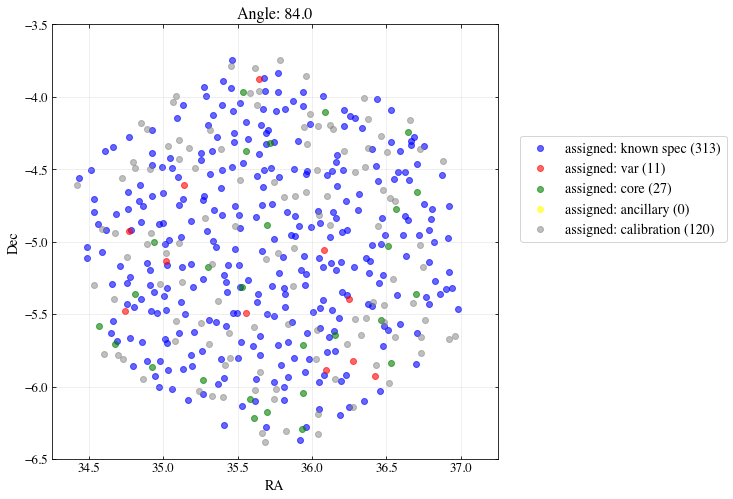

...

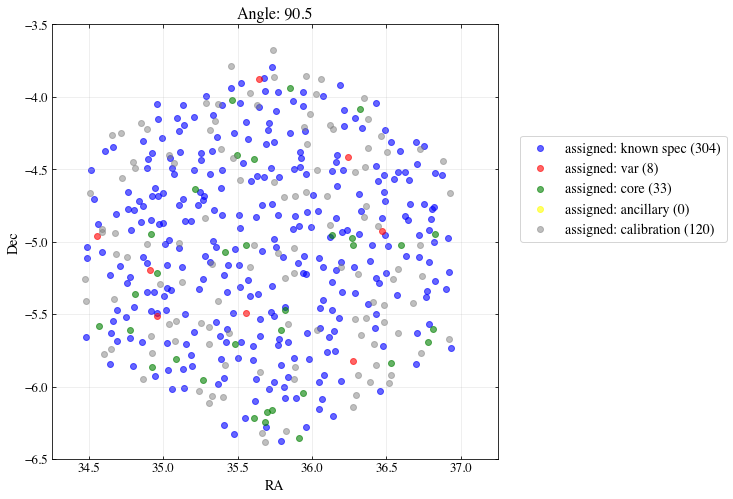

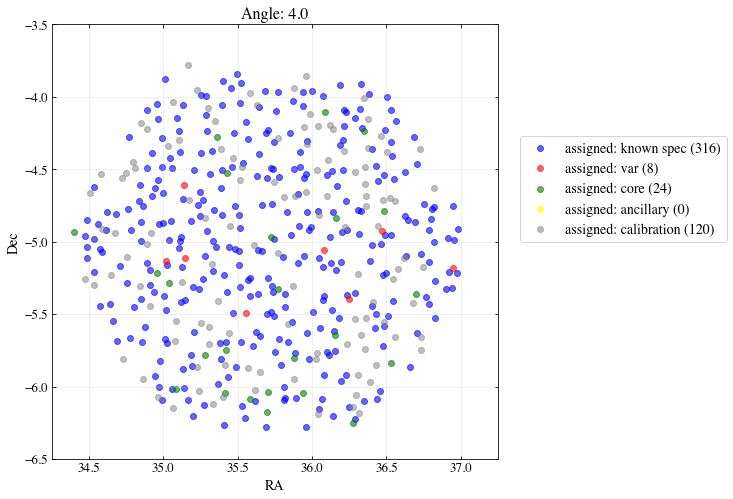

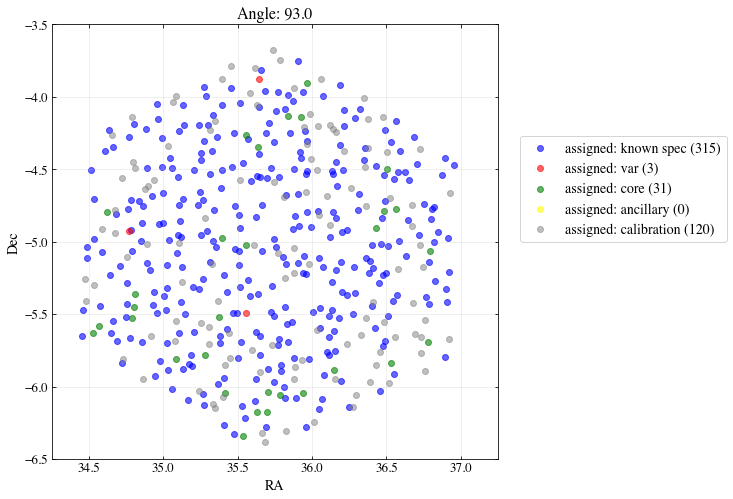

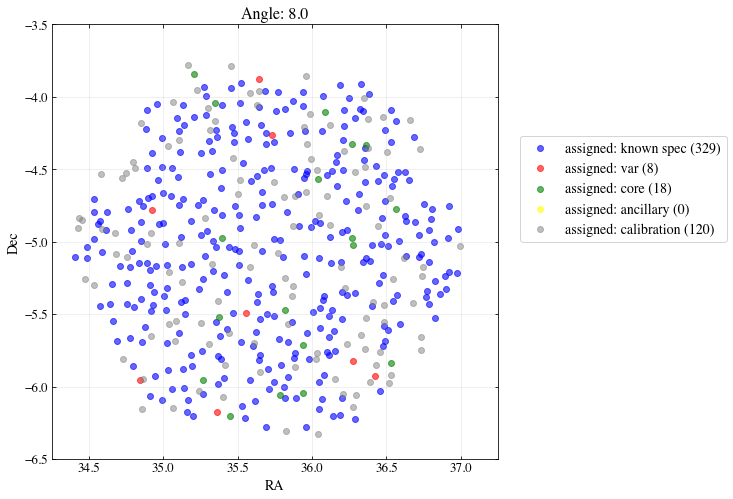

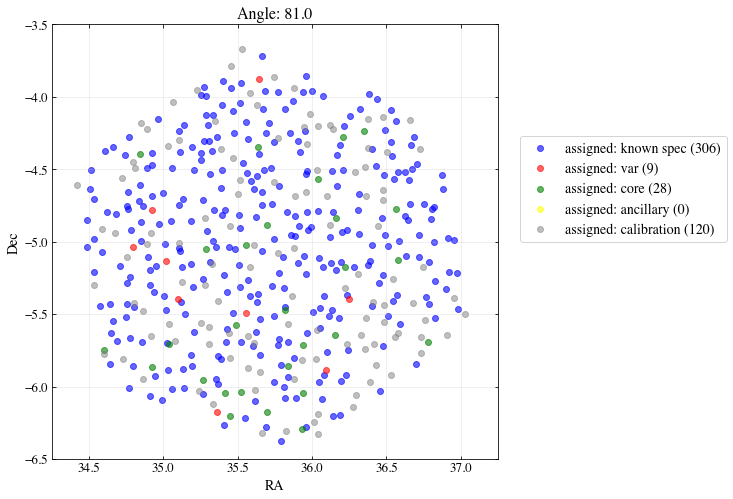

In [23]:
# n = 0
# for i in files:
#     data2 = Table.read(i, hdu = 2, format='fits')
#     data1 = Table.read(i, hdu = 1, format='fits')
#     angle = float(i.split("_")[1].split(".fits")[0])

#     assigned_SCIENCEfibers = ((data2['assigned'] == 1) & (data1['category'] == 'science'))
#     assigned_CALIBfibers = ((data2['assigned'] == 1) & ((data1['category'] == 'sky_boss') | (data1['category'] == 'standard_boss')))


#     #Carton breakdown
#     assigned_known = ((data2['assigned'] == 1) & (data1['carton'] == 'bhm_rm_known_spec'))
#     assigned_core = ((data2['assigned'] == 1) & (data1['carton'] == 'bhm_rm_core'))
#     assigned_var = ((data2['assigned'] == 1) & (data1['carton'] == 'bhm_rm_var'))
#     assigned_ancil = ((data2['assigned'] == 1) & (data1['carton'] == 'bhm_rm_ancillary'))
#     #plt.figure(figsize=(10,10))
#     fig, axs = plt.subplots(1, 1, figsize=(8, 8))
#     axs.grid(alpha=0.25, zorder=0)
#     axs.scatter(data1["ra"][assigned_known], data1["dec"][assigned_known],
#                 color = "blue", alpha = 0.6, 
#                 label="assigned: known spec ({})".format(len(data1["ra"][assigned_known])))
#     axs.scatter(data1["ra"][assigned_var], data1["dec"][assigned_var],
#                 color = "red", alpha = 0.6, 
#                 label="assigned: var ({})".format(len(data1["ra"][assigned_var])))
#     axs.scatter(data1["ra"][assigned_core], data1["dec"][assigned_core],
#                 color = "green", alpha = 0.6, 
#                 label="assigned: core ({})".format(len(data1["ra"][assigned_core])))
#     axs.scatter(data1["ra"][assigned_ancil], data1["dec"][assigned_ancil],
#                 color = "yellow", alpha = 0.6, 
#                 label="assigned: ancillary ({})".format(len(data1["ra"][assigned_ancil])))
#     axs.scatter(data1["ra"][assigned_CALIBfibers], data1["dec"][assigned_CALIBfibers],
#                 color = "gray", alpha = 0.5, 
#                 label="assigned: calibration ({})".format(len(data1["ra"][assigned_CALIBfibers])))
#     axs.legend(loc=(1.05,0.5), prop={"size":size})
#     axs.set_xlabel('RA', fontsize=size)
#     axs.set_ylabel('Dec', fontsize=size)
#     axs.set_title("Angle: {}".format(angle), fontsize=size+2)
#     axs.tick_params(axis='both', which='major', labelsize=size-1, 
#                    top=True, right=True, bottom=True, left=True, direction='in')
#     axs.tick_params(axis='both', which='minor', labelsize=size-1, 
#                    top=True, right=True, bottom=True, left=True, direction='in')
#     axs.set_ylim(-6.5, -3.5)
#     axs.set_xlim(34.25, 37.25)

#     plt.savefig("img_{}.png".format(angle), bbox_inches ='tight',dpi=300)

#     plt.show()

In [42]:
# import glob
# from PIL import Image

# ##filepaths
# fp_in = "./img_*.png"
# fp_out = "./designs.gif"

# # # https://pillow.readthedocs.io/en/stable/handbook/image-file-formats.html#gif
# img, *imgs = [Image.open(f) for f in sorted(glob.glob(fp_in))]
# img.save(fp=fp_out, format='GIF', append_images=imgs,
#           save_all=True, duration=200, loop=0)



TypeError: 'NoneType' object is not iterable

# Are there common robots that are not assigned?

In [40]:
not_assigned = []
for i in files:
    data2 = Table.read(i, hdu = 2, format='fits')
    data1 = Table.read(i, hdu = 1, format='fits')
    robots = np.arange(1,501,1)
    assigned_robots = data2['robotID'][np.where(data2['robotID'][:,1] != -1)[0]][:,1]
    not_assigned.extend(list(np.setdiff1d(robots, assigned_robots)))

In [41]:
not_assigned = np.array(not_assigned)

array([ 11,  18,  32, ..., 478, 492, 496])

In [42]:
len(not_assigned)

8862

In [46]:
from collections import Counter
c = Counter(not_assigned)
len(files)

305

In [53]:
c.most_common(20)

[(485, 124),
 (492, 118),
 (498, 118),
 (141, 101),
 (496, 81),
 (404, 71),
 (477, 70),
 (424, 66),
 (232, 65),
 (472, 64),
 (490, 63),
 (164, 62),
 (327, 62),
 (333, 62),
 (243, 61),
 (212, 61),
 (483, 60),
 (351, 60),
 (294, 59),
 (42, 57)]

In [1]:
57/305

0.18688524590163935

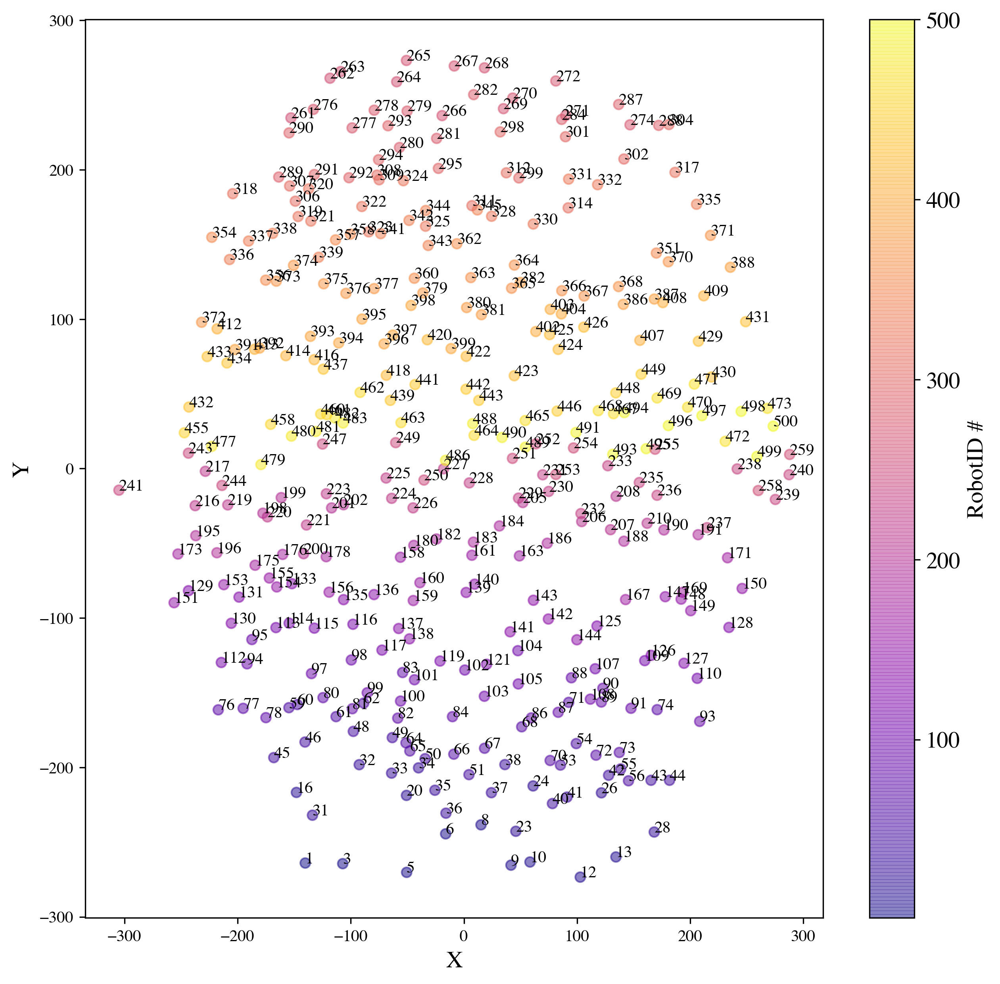

In [79]:
size=14
## now where are these fibers/robots
data2 = Table.read(files[3], hdu = 2, format='fits')
data1 = Table.read(files[3], hdu = 1, format='fits')
#angle = float(i.split("_")[1].split(".fits")[0])

assigned_SCIENCEfibers = ((data2['assigned'] == 1) & (data1['category'] == 'science'))
assigned_CALIBfibers = ((data2['assigned'] == 1) & ((data1['category'] == 'sky_boss') | (data1['category'] == 'standard_boss')))


#Carton breakdown
assigned_known = ((data2['assigned'] == 1) & (data1['carton'] == 'bhm_rm_known_spec'))

cols = data2['robotID'][assigned_SCIENCEfibers][:,1]
size = 14

#fig
fig, ax = plt.subplots(figsize=(10, 10), dpi=300, facecolor='white')

#plot
ec = ax.scatter(data1['x'][assigned_SCIENCEfibers], data1['y'][assigned_SCIENCEfibers], 
                alpha=0.5, c=cols,cmap='plasma')
ax.set_xlabel('X', fontsize=size)
ax.set_ylabel('Y', fontsize=size)

for i, txt in enumerate(data2['robotID'][assigned_SCIENCEfibers][:,1]):
    ax.annotate(txt, (data1['x'][assigned_SCIENCEfibers][i],  data1['y'][assigned_SCIENCEfibers][i]))
#colorbar stuff
cbar = plt.colorbar(ec)
cbar.set_label('RobotID #', fontsize=size)
cbar.ax.tick_params(labelsize=size)
#plt.savefig("robotID_layout2.png".format(angle), bbox_inches ='tight',dpi=300)

In [66]:
data2["robotID"][assigned_SCIENCEfibers][0]

array([498, 498, 498, ..., 498, 498, 498], dtype=int32)